### Laboratorium 5 - zadania - transformacja Hougha

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

#### Zadanie 1

Zbadaj wpływ parametrów transformacji Hougha na jakość detekcji prostych na przykładzie obrazu `norway`. Wykorzystaj ulubiony detektor krawędzi i zaprezentuj jego wynik przed użyciem transformacji Hougha. Zapoznaj się z dokumentacją funkcji [`cv2.HoughLines`](https://docs.opencv.org/4.5.3/dd/d1a/group__imgproc__feature.html#ga46b4e588934f6c8dfd509cc6e0e4545a), zwłaszcza parametrami sterującymi rozdzielczością `rho`, `theta` oraz progiem (`threshold`). Błędnie dobrany próg może szczególnie negatywnie wpłynąć na wyniki.

Zacznij od znalezienia odpowiednich parametrów detektora krawędzi - jeśli na tym etapie wyniki będą słabe, to dalej będzie tylko gorzej (_garbage-in, garbage-out_) - ale nie skupiaj się na badaniu ich wpływu na wyniki.

Zadanie _nie_ polega na zrobieniu grid searcha parametrów transformacji Hougha, tylko na zrozumieniu zachowania parametrów `rho` i `theta`, oraz wpływu progu.

Ostateczny rezultat zaprezentuj w postaci odcinków naniesionych na kopię obrazu wejściowego (patrz komórka `[3]`).

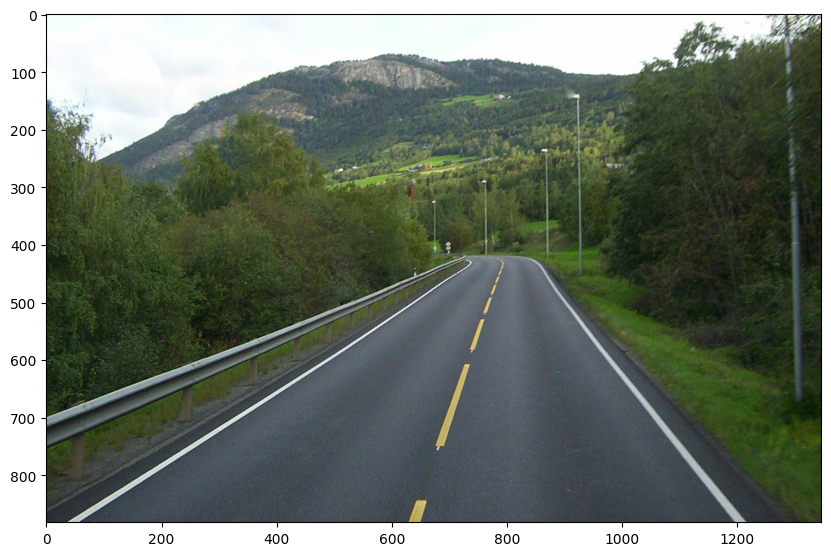

In [2]:
norway = cv2.imread('Lab5_dane/norway.jpg')
plt.subplots(1, 1, figsize=(10,10))[1].imshow(norway[..., ::-1]);

In [3]:
def rhotheta2xy(line):
    # konwersja parametrów prostej w układzie rho-theta do odcinka w układzie kartezjańskim
    # wynik można użyć jako argumenty funkcji cv2.line
    rho, theta = line[0]
    a = np.cos(theta)
    b = np.sin(theta)
    x0 = a*rho
    y0 = b*rho
    x1 = int(x0 + 5000*(-b))
    y1 = int(y0 + 5000*(a))
    x2 = int(x0 - 5000*(-b))
    y2 = int(y0 - 5000*(a))
    return x1, y1, x2, y2

Rozwiązanie:

In [4]:
gray = cv2.cvtColor(norway, cv2.COLOR_BGR2GRAY)

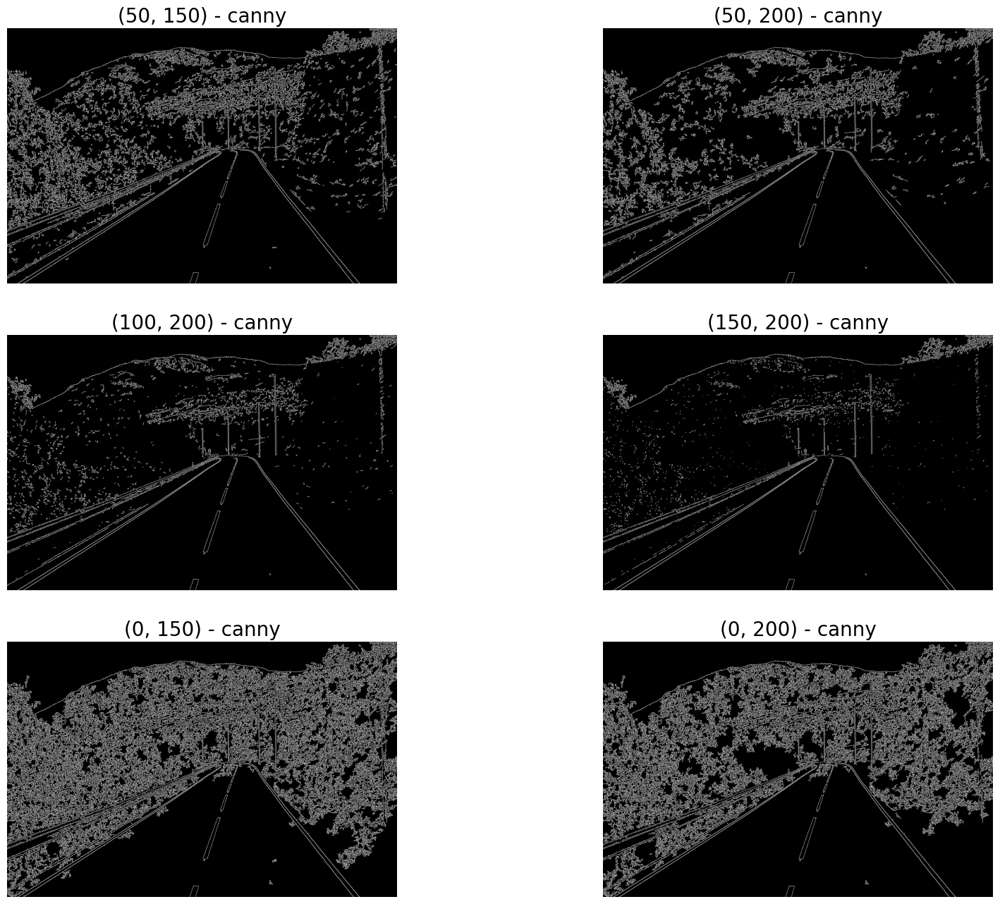

In [5]:
plt.figure(figsize=(20, 16))
thresholds = [(50, 150), (50, 200), (100, 200), (150, 200), (0, 150), (0, 200)]
for i, threshold in enumerate(thresholds):
    plt.subplot(3, 2, i + 1)
    plt.imshow(cv2.Canny(gray, *threshold), cmap='gray')
    plt.title(f'{threshold} - canny', fontsize=20)
    plt.axis('off')

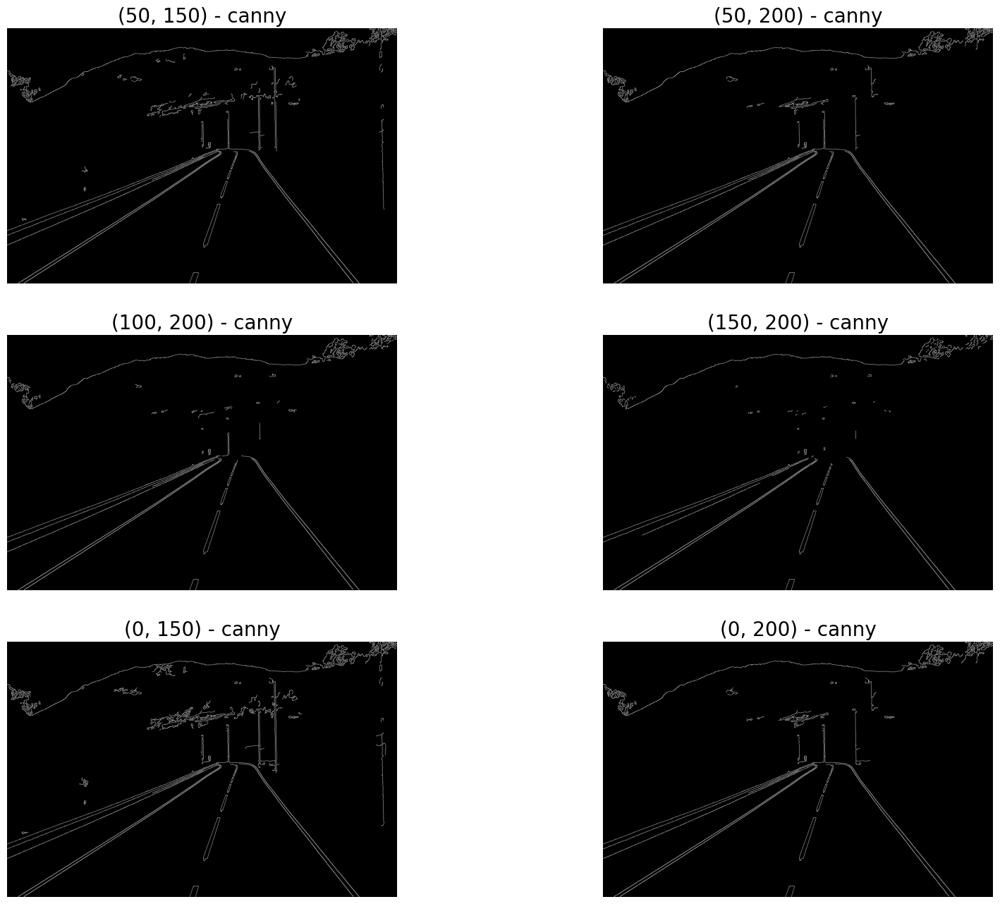

In [6]:
gray_blured = cv2.GaussianBlur(gray, (7, 7), 0)

plt.figure(figsize=(20, 16))
thresholds = [(50, 150), (50, 200), (100, 200), (150, 200), (0, 150), (0, 200)]
for i, threshold in enumerate(thresholds):
    plt.subplot(3, 2, i + 1)
    plt.imshow(cv2.Canny(gray_blured, *threshold), cmap='gray')
    plt.title(f'{threshold} - canny', fontsize=20)
    plt.axis('off')

In [7]:
canny = cv2.Canny(cv2.GaussianBlur(gray, (7, 7), 0), 0, 200)

In [8]:
def test_hogh(params, test_param, test_values):

    plt.figure(figsize=(20, 12))
    for i, val in enumerate(test_values):
        curr_params = params.copy()
        curr_params[test_param] = val
        lines = cv2.HoughLines(canny, **curr_params)
        img = cv2.cvtColor(norway, cv2.COLOR_BGR2RGB)
        for line in lines:
            x1, y1, x2, y2 = rhotheta2xy(line)
            cv2.line(img, (x1, y1), (x2, y2), (0,0,255), 1, cv2.LINE_AA)
             
        plt.subplot(2, 2, i + 1)
        plt.imshow(img)
        plt.title(f'{test_param}={val}', fontsize=20)
        plt.axis('off')

In [9]:
params = {"rho": 1, "theta": np.pi / 180, "threshold": 150}

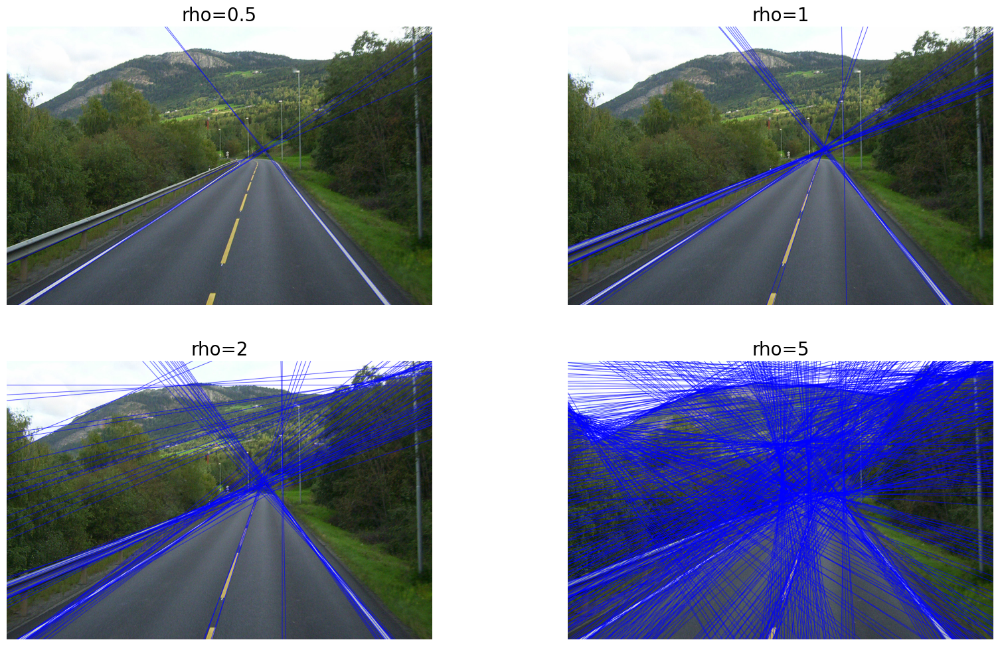

In [10]:
test_hogh({"rho": 1, "theta": np.pi / 180, "threshold": 150}, 'rho', [0.5, 1, 2, 5])

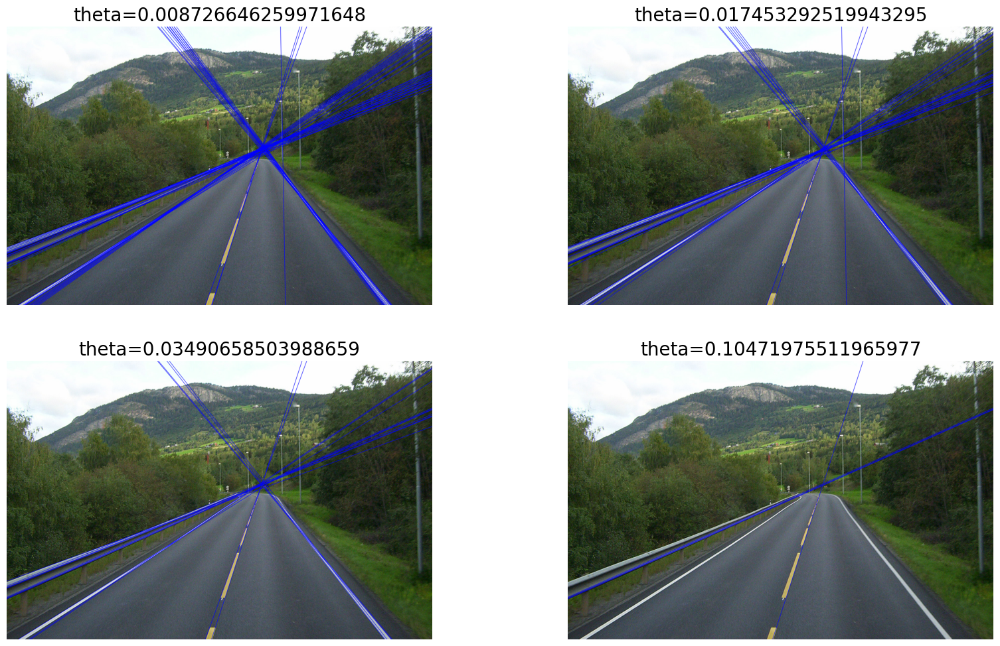

In [11]:
test_hogh({"rho": 1, "theta": np.pi / 180, "threshold": 150}, 'theta', [np.pi / 360, np.pi / 180, np.pi / 90, np.pi / 30])

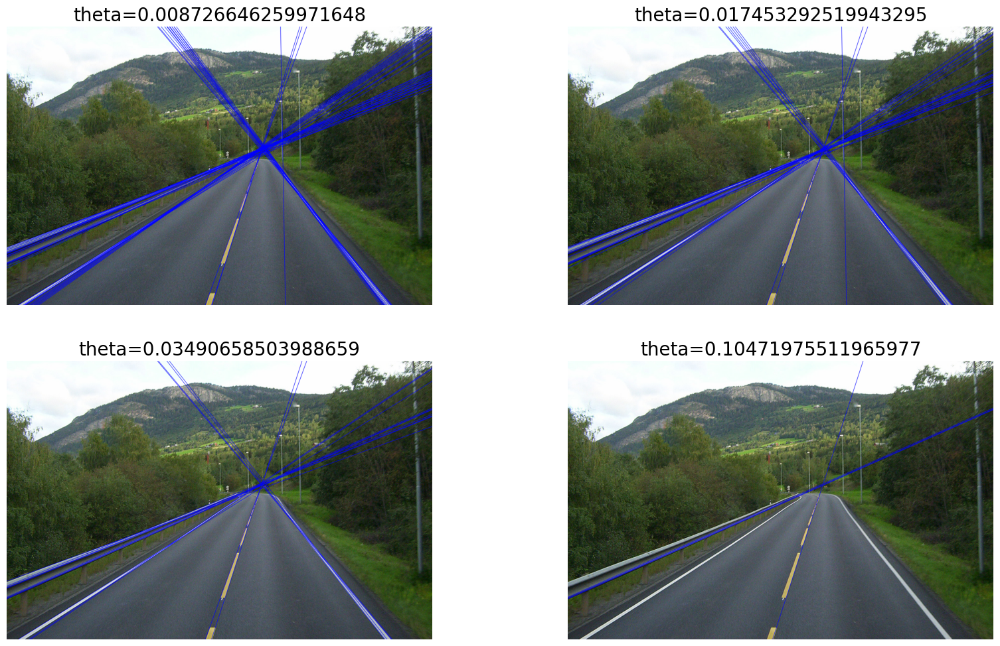

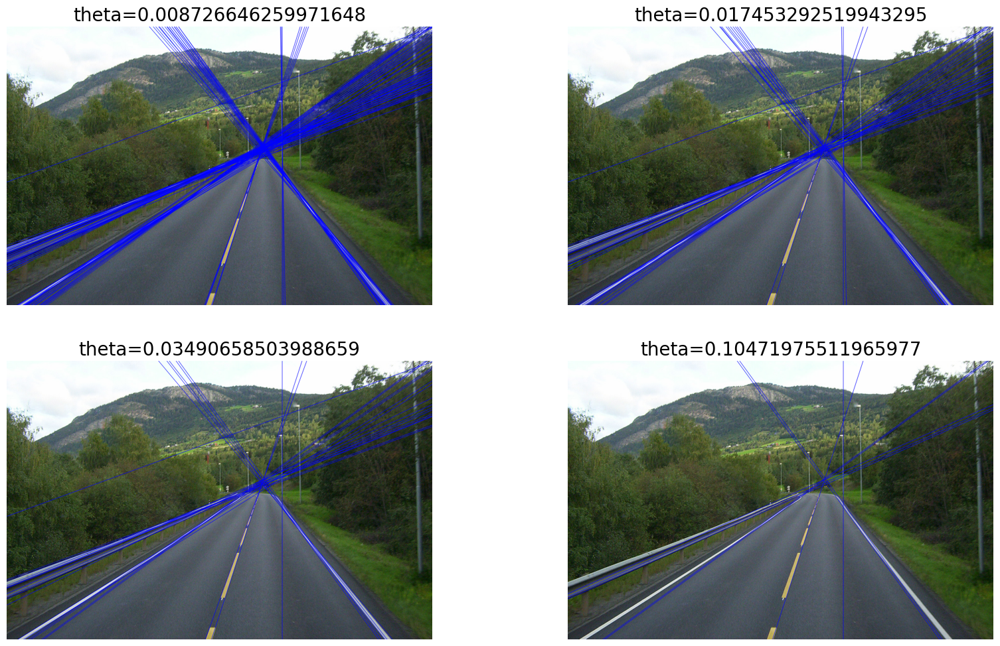

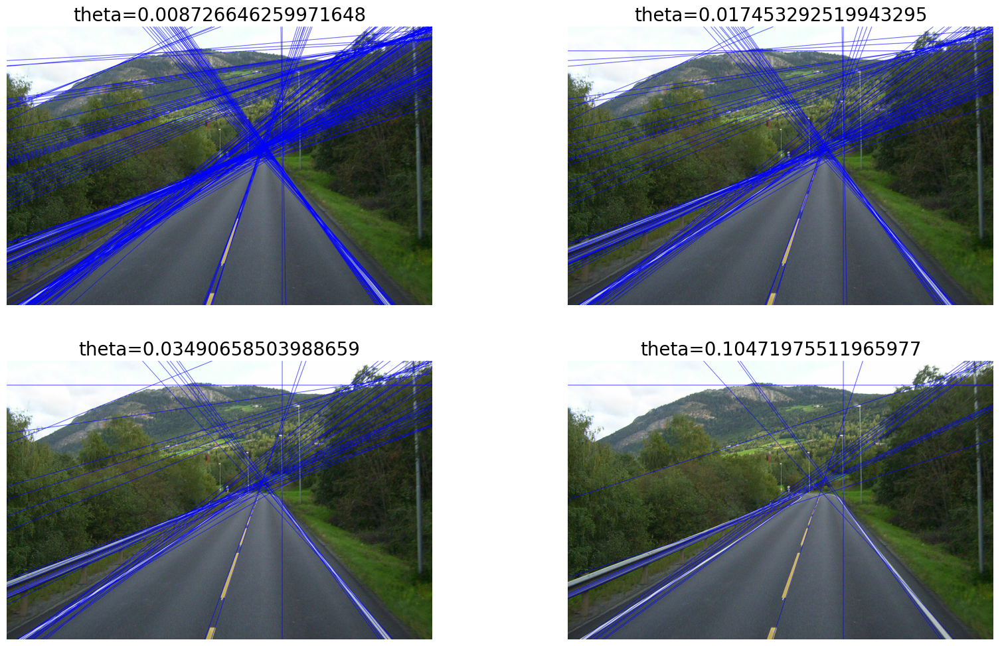

In [19]:
test_hogh({"rho": 1, "theta": np.pi / 180, "threshold": 150}, 'theta', [np.pi / 360, np.pi / 180, np.pi / 90, np.pi / 30])
test_hogh({"rho": 1.5, "theta": np.pi / 180, "threshold": 150}, 'theta', [np.pi / 360, np.pi / 180, np.pi / 90, np.pi / 30])
test_hogh({"rho": 2, "theta": np.pi / 180, "threshold": 150}, 'theta', [np.pi / 360, np.pi / 180, np.pi / 90, np.pi / 30])

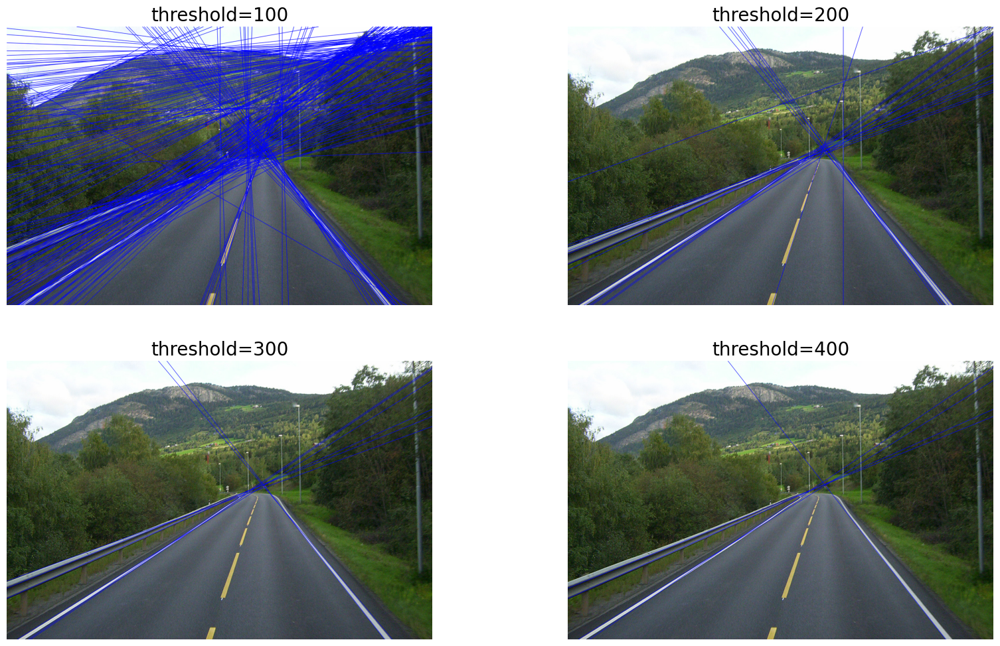

In [23]:
test_hogh({"rho": 2, "theta": np.pi / 90, "threshold": 150}, 'threshold', [100, 200, 300, 400])

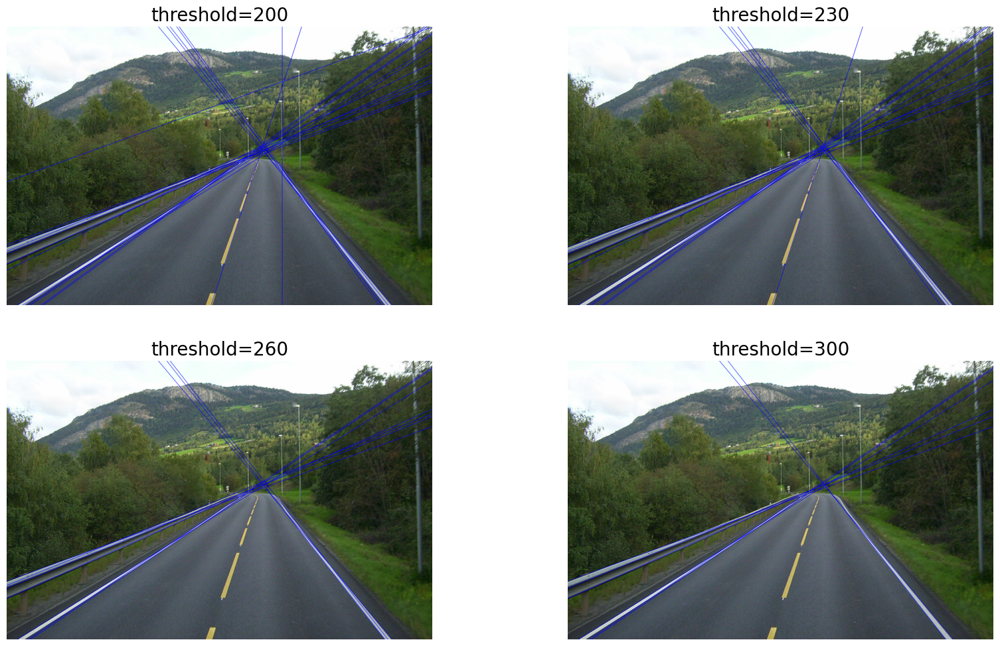

In [24]:
test_hogh({"rho": 2, "theta": np.pi / 90, "threshold": 150}, 'threshold', [200, 230, 260, 300])

#### Zadanie 2

Dany jest obraz `pillbox`. Wykorzystaj transformację Hougha dla prostych, aby wykryć krawędzie między komórkami organizera.

Dla odmiany, w tym zadaniu nie jest istotne badanie parametrów ale wyłącznie końcowy wynik.

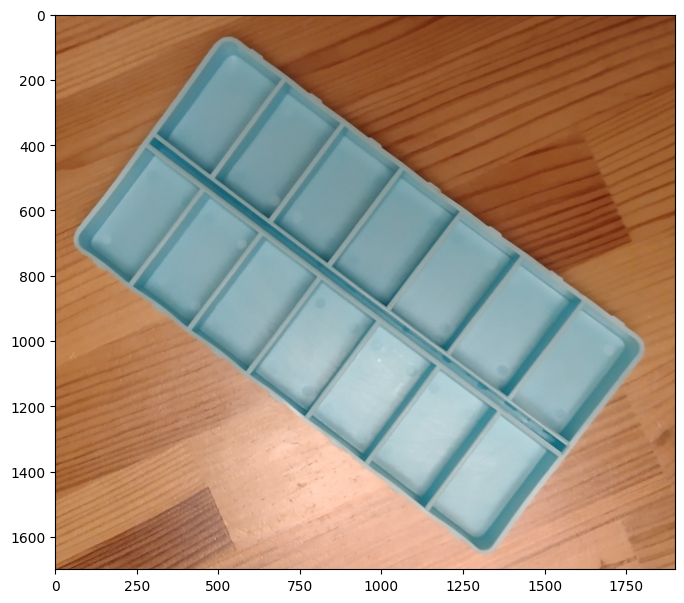

In [13]:
pillbox = cv2.imread('Lab5_dane/pillbox.png')
plt.subplots(1, 1, figsize=(8,8))[1].imshow(pillbox[..., ::-1]);

Rozwiązanie:

In [14]:
def find_intersection(x1, y1, x2, y2, x3, y3, x4, y4):
    a1 = (y2 - y1) / (x2 - x1) if x2 != x1 else np.inf
    b1 = y1 - a1 * x1 if a1 != np.inf else x1

    a2 = (y4 - y3) / (x4 - x3) if x4 != x3 else np.inf
    b2 = y3 - a2 * x3 if a2 != np.inf else x3

    if a1 == a2: return None

    x = (b2 - b1) / (a1 - a2)
    y = a1 * x + b1

    return (x, y)

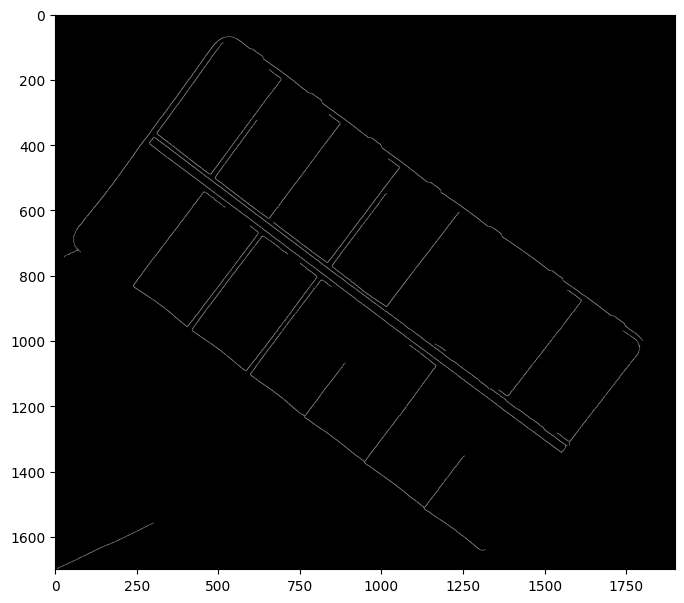

In [29]:
pills_gray = cv2.cvtColor(pillbox, cv2.COLOR_BGR2GRAY)
pills_blured = cv2.GaussianBlur(pills_gray, (7, 7), 0)
pills_canny = cv2.Canny(pills_blured, 0, 190)

plt.subplots(1, 1, figsize=(8,8))[1].imshow(pills_canny, cmap='gray')

In [ ]:
def test_hogh2(params, test_param, test_values):

    plt.figure(figsize=(20, 12))
    for i, val in enumerate(test_values):
        curr_params = params.copy()
        curr_params[test_param] = val
        lines = cv2.HoughLines(pills_canny, **curr_params)
        img = cv2.cvtColor(pillbox, cv2.COLOR_BGR2RGB)
        for line in lines:
            x1, y1, x2, y2 = rhotheta2xy(line)
            cv2.line(img, (x1, y1), (x2, y2), (0,0,255), 1, cv2.LINE_AA)
             
        plt.subplot(2, 2, i + 1)
        plt.imshow(img)
        plt.title(f'{test_param}={val}', fontsize=20)
        plt.axis('off')

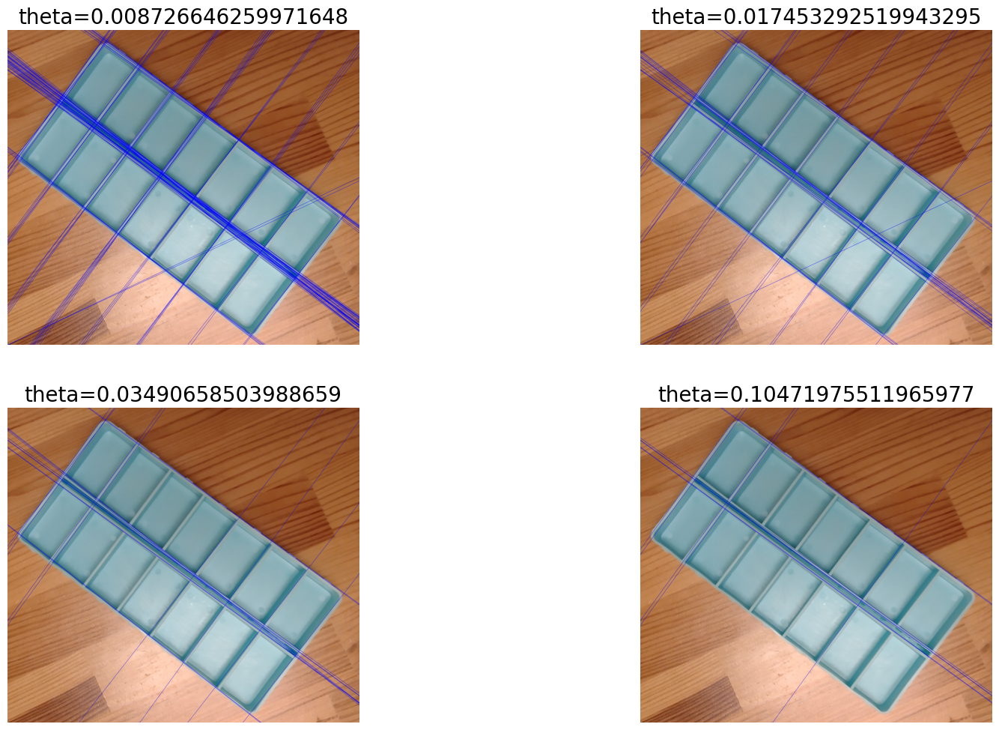

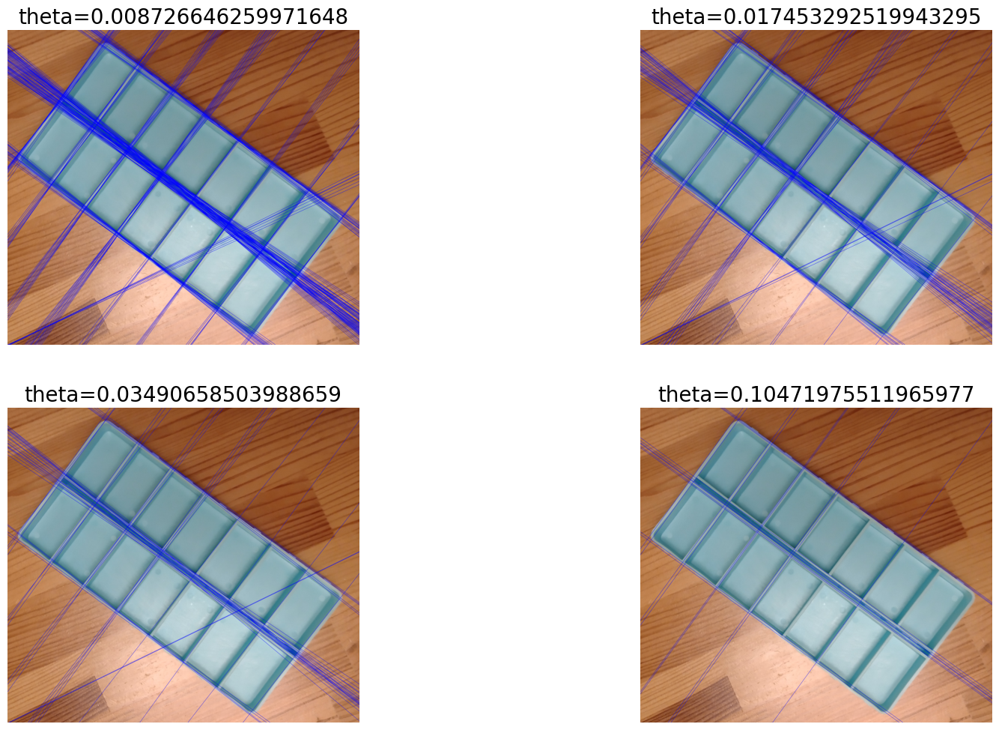

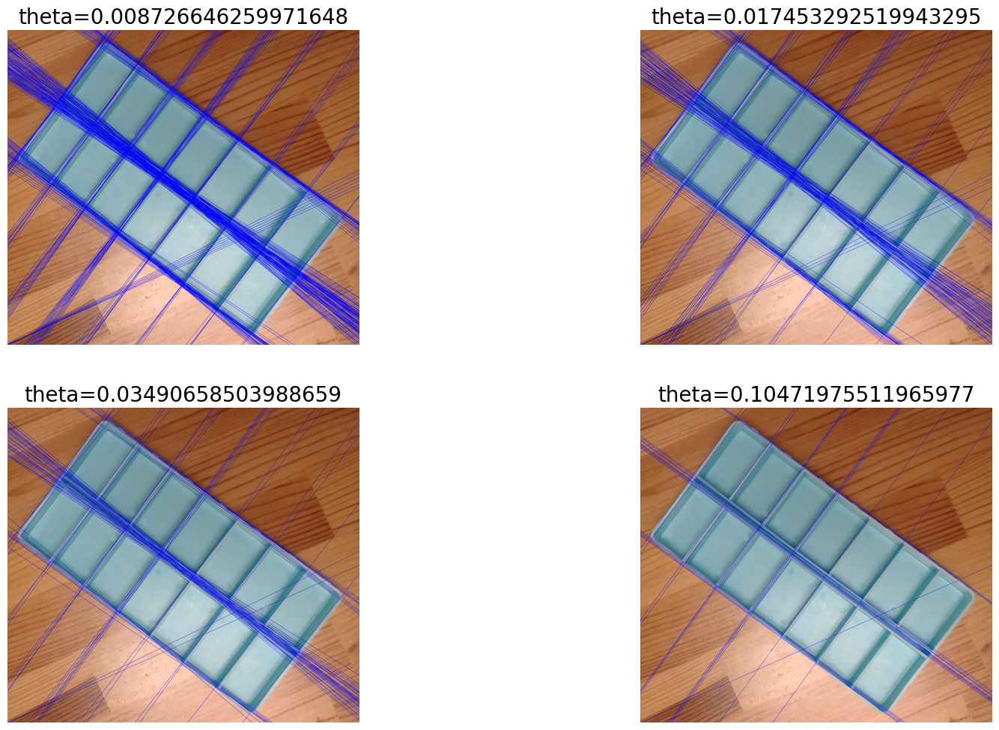

In [30]:
test_hogh2({"rho": 1, "theta": np.pi / 180, "threshold": 150}, 'theta', [np.pi / 360, np.pi / 180, np.pi / 90, np.pi / 30])
test_hogh2({"rho": 1.5, "theta": np.pi / 180, "threshold": 150}, 'theta', [np.pi / 360, np.pi / 180, np.pi / 90, np.pi / 30])
test_hogh2({"rho": 2, "theta": np.pi / 180, "threshold": 150}, 'theta', [np.pi / 360, np.pi / 180, np.pi / 90, np.pi / 30])

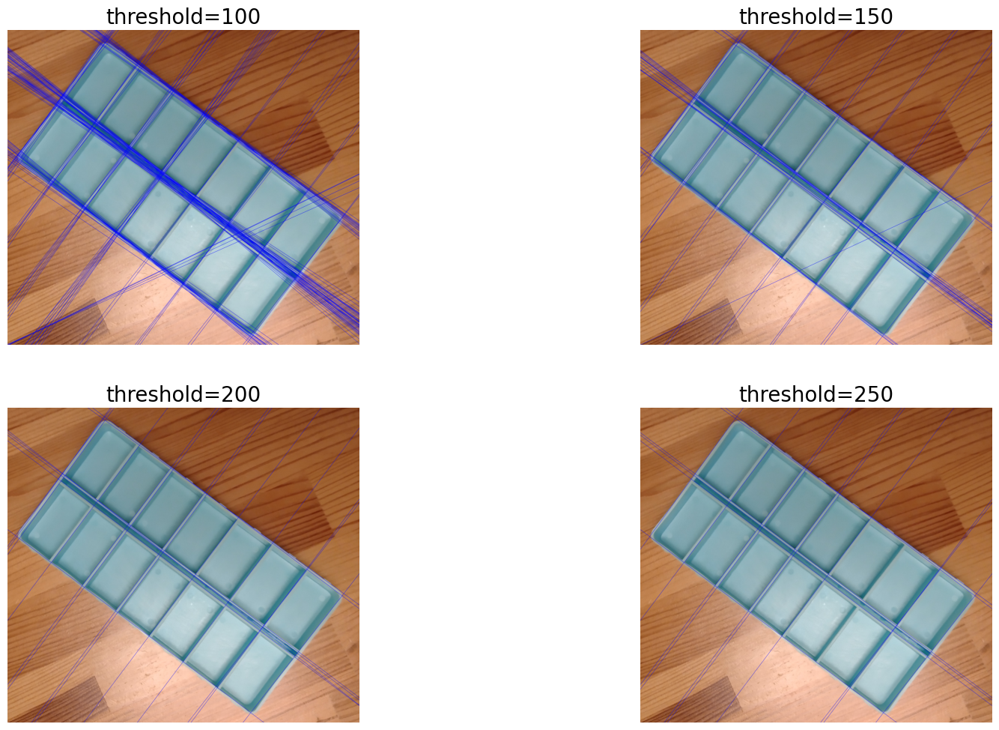

In [31]:
test_hogh2({"rho": 1, "theta": np.pi / 180, "threshold": 150}, 'threshold', [100, 150, 200, 250])

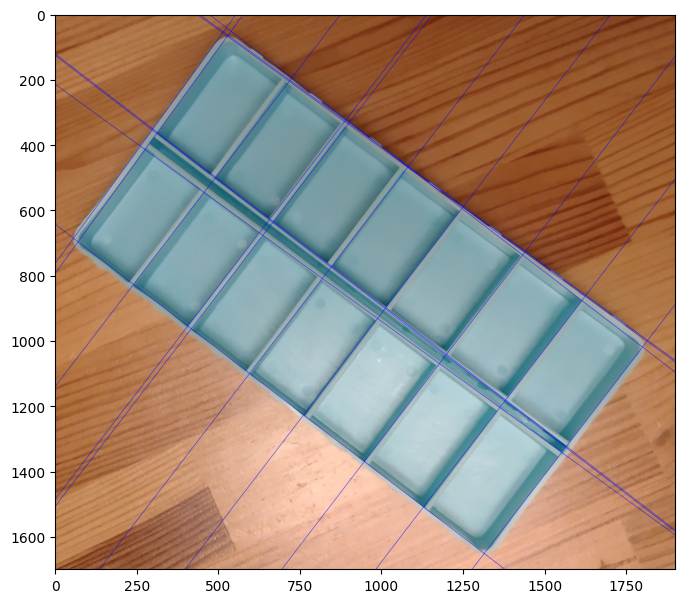

In [35]:
lines = cv2.HoughLines(pills_canny, 0.8, np.pi / 120, 155)
img = cv2.cvtColor(pillbox, cv2.COLOR_BGR2RGB)
lines_xy = []
for line in lines:
    x1, y1, x2, y2 = rhotheta2xy(line)
    lines_xy.append((x1, y1, x2, y2))
    cv2.line(img, (x1, y1), (x2, y2), (0,0,255), 1, cv2.LINE_AA)
        
plt.subplots(1, 1, figsize=(8,8))[1].imshow(img)

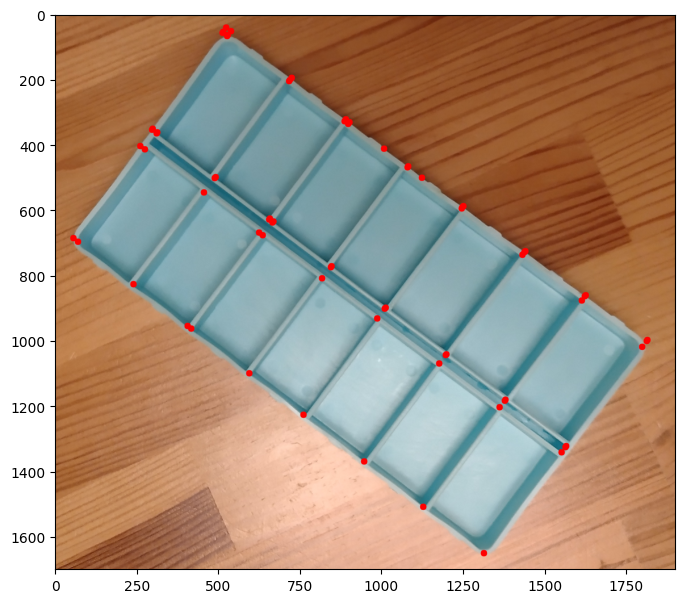

In [36]:
img = cv2.cvtColor(pillbox, cv2.COLOR_BGR2RGB)

for i in range(len(lines_xy)):
    for j in range(i + 1, len(lines_xy)):
        intersection = find_intersection(*lines_xy[i], *lines_xy[j])
        if intersection is not None:
            x, y = intersection
            cv2.circle(img, (int(x), int(y)), 10, (255, 0, 0), -1)

plt.subplots(1, 1, figsize=(8,8))[1].imshow(img)